## 📍프로젝트 : Segmentation map으로 도로 이미지 만들기


### 데이터 확인 & 준비

In [33]:
import os


train_data_path = './cityscapes/train/'
test_data_path = './cityscapes/val/'


print("number of train examples :", len(os.listdir(train_data_path)))
print("number of train examples :", len(os.listdir(test_data_path)))

number of train examples : 1000
number of train examples : 5


파일크기 (256, 512, 3)


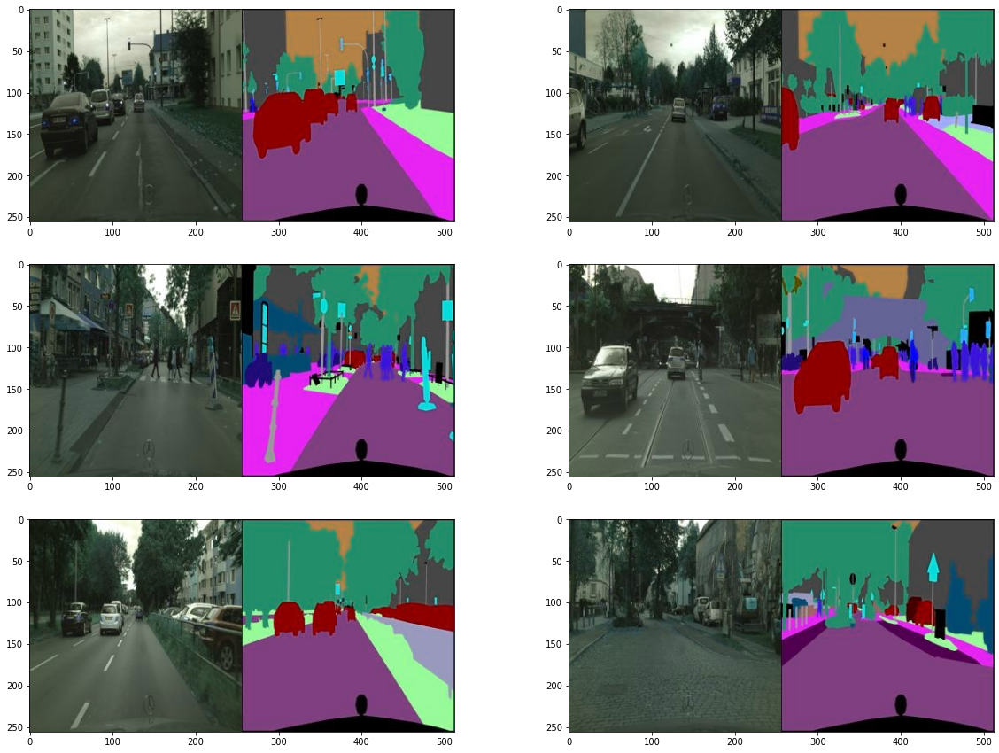

In [2]:
# 데이터 확인(?)
import cv2
import numpy as np
import matplotlib.pyplot as plt

plt.figure(figsize=(20,15))
for i,file in enumerate(os.listdir(train_data_path)):
    if i >= 6:
        break;
    img = cv2.imread(os.path.join(train_data_path,file), cv2.IMREAD_COLOR)
    plt.subplot(3,2,i+1)
    plt.imshow(img)
print("파일크기" , img.shape)

### 이미지 분할

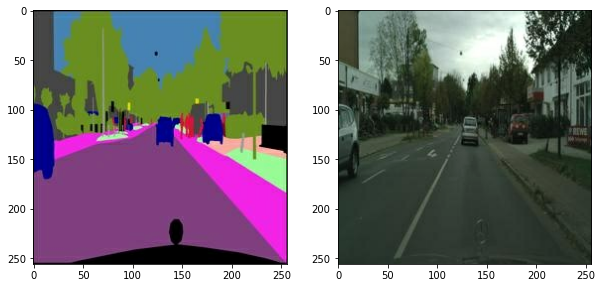

In [4]:
import tensorflow as tf

def normalize(x):
    x = tf.cast(x, tf.float32)
    return (x/127.5) - 1

def denormalize(x):
    x = (x+1)*127.5
    x = x.numpy()
    return x.astype(np.uint8)

def load_img(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, 3)
    
    w = tf.shape(img)[1] // 2
    sketch = img[:, w:, :] 
    sketch = tf.cast(sketch, tf.float32)
    colored = img[:, :w, :] 
    colored = tf.cast(colored, tf.float32)
    return normalize(sketch), normalize(colored)

# 이미지 분할 테스트
f = train_data_path + os.listdir(train_data_path)[1]
sketch, colored = load_img(f)

plt.figure(figsize=(10,7))
plt.subplot(1,2,1); plt.imshow(denormalize(sketch))
plt.subplot(1,2,2); plt.imshow(denormalize(colored))

### augmentation 처리

In [5]:
from tensorflow import image
from tensorflow.keras.preprocessing.image import random_rotation

@tf.function() # 빠른 텐서플로 연산을 위해 @tf.function()을 사용합니다. 
def apply_augmentation(sketch, colored):
    stacked = tf.concat([sketch, colored], axis=-1)
    
    _pad = tf.constant([[30,30],[30,30],[0,0]])
    if tf.random.uniform(()) < .5:
        padded = tf.pad(stacked, _pad, "REFLECT")
    else:
        padded = tf.pad(stacked, _pad, "CONSTANT", constant_values=1.)

    out = image.random_crop(padded, size=[256, 256, 6])
    
    out = image.random_flip_left_right(out)
    out = image.random_flip_up_down(out)
    
    if tf.random.uniform(()) < .5:
        degree = tf.random.uniform([], minval=1, maxval=4, dtype=tf.int32)
        out = image.rot90(out, k=degree)
    
    return out[...,:3], out[...,3:]   

두 이미지가 채널 축으로 연결됩니다. (tf.concat). 두 이미지가 각각 3채널인 경우 6채널이 됩니다.
1.의 결과에 각 50% 확률로 Refection padding 또는 constant padding이 30픽셀의 pad width 만큼적용됩니다. (tf.pad)
2.의 결과에서 (256,256,6) 크기를 가진 이미지를 임의로 잘라냅니다. (tf.image.random_crop)
3.의 결과를 50% 확률로 가로로 뒤집습니다. (tf.image.random_flip_left_right)
4.의 결과를 50% 확률로 세로로 뒤집습니다. (tf.image.random_flip_up_down)
5.의 결과를 50% 확률로 회전시킵니다. (tf.image.rot90)

### augmentation 확인

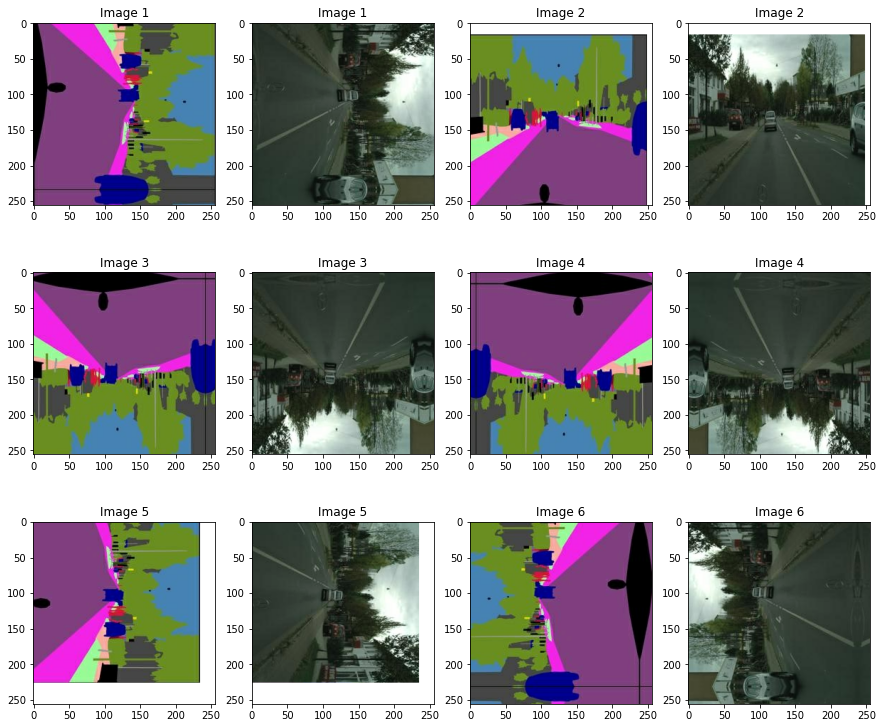

In [6]:
plt.figure(figsize=(15,13))
img_n = 1
for i in range(1, 13, 2):
    augmented_sketch, augmented_colored = apply_augmentation(sketch, colored)
    
    plt.subplot(3,4,i)
    plt.imshow(denormalize(augmented_sketch)); plt.title(f"Image {img_n}")
    plt.subplot(3,4,i+1); 
    plt.imshow(denormalize(augmented_colored)); plt.title(f"Image {img_n}")
    img_n += 1

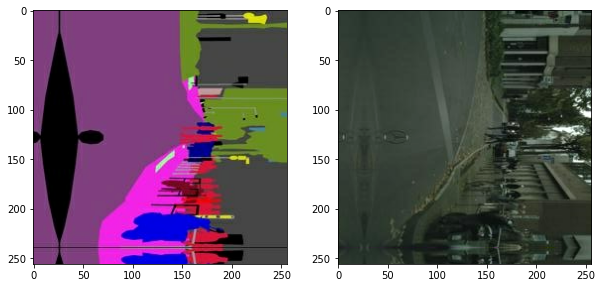

In [7]:
from tensorflow import data

def get_train(img_path):
    sketch, colored = load_img(img_path)
    sketch, colored = apply_augmentation(sketch, colored)
    return sketch, colored

train_images = data.Dataset.list_files(train_data_path + "*.jpg")
train_images = train_images.map(get_train).shuffle(100).batch(4)

sample = train_images.take(1)
sample = list(sample.as_numpy_iterator())
sketch, colored = (sample[0][0]+1)*127.5, (sample[0][1]+1)*127.5

plt.figure(figsize=(10,5))
plt.subplot(1,2,1); plt.imshow(sketch[0].astype(np.uint8))
plt.subplot(1,2,2); plt.imshow(colored[0].astype(np.uint8))

### U-Net Encoder  Decoder

In [8]:
from tensorflow.keras import layers, Input, Model

# EncodeBlock
class EncodeBlock(layers.Layer):
    def __init__(self, n_filters, use_bn=True):
        super(EncodeBlock, self).__init__()
        self.use_bn = use_bn       
        self.conv = layers.Conv2D(n_filters, 4, 2, "same", use_bias=False)
        self.batchnorm = layers.BatchNormalization()
        self.lrelu = layers.LeakyReLU(0.2)

    def call(self, x):
        x = self.conv(x)
        if self.use_bn:
            x = self.batchnorm(x)
        return self.lrelu(x)

# DecodeBlock
class DecodeBlock(layers.Layer):
    def __init__(self, f, dropout=True):
        super(DecodeBlock, self).__init__()
        self.dropout = dropout
        self.Transconv = layers.Conv2DTranspose(f, 4, 2, "same", use_bias=False)
        self.batchnorm = layers.BatchNormalization()
        self.relu = layers.ReLU()
        
    def call(self, x):
        x = self.Transconv(x)
        x = self.batchnorm(x)
        if self.dropout:
            x = layers.Dropout(.5)(x)
        return self.relu(x)

In [9]:
# UNetGenerator
class UNetGenerator(Model):
    def __init__(self):
        super(UNetGenerator, self).__init__()
        encode_filters = [64,128,256,512,512,512,512,512]
        decode_filters = [512,512,512,512,256,128,64]
        
        self.encode_blocks = []
        for i, f in enumerate(encode_filters):
            if i == 0:
                self.encode_blocks.append(EncodeBlock(f, use_bn=False))
            else:
                self.encode_blocks.append(EncodeBlock(f))
        
        self.decode_blocks = []
        for i, f in enumerate(decode_filters):
            if i < 3:
                self.decode_blocks.append(DecodeBlock(f))
            else:
                self.decode_blocks.append(DecodeBlock(f, dropout=False))
        
        self.last_conv = layers.Conv2DTranspose(3, 4, 2, "same", use_bias=False)
    
    def call(self, x):
        features = []
        for block in self.encode_blocks:
            x = block(x)
            features.append(x)
        
        features = features[:-1]
                    
        for block, feat in zip(self.decode_blocks, features[::-1]):
            x = block(x)
            x = layers.Concatenate()([x, feat])
        
        x = self.last_conv(x)
        return x
                
    def get_summary(self, input_shape=(256,256,3)):
        inputs = Input(input_shape)
        return Model(inputs, self.call(inputs)).summary()

In [10]:
# 레이어들 확인 
UNetGenerator().get_summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
encode_block (EncodeBlock)      (None, 128, 128, 64) 3072        input_1[0][0]                    
__________________________________________________________________________________________________
encode_block_1 (EncodeBlock)    (None, 64, 64, 128)  131584      encode_block[0][0]               
__________________________________________________________________________________________________
encode_block_2 (EncodeBlock)    (None, 32, 32, 256)  525312      encode_block_1[0][0]             
______________________________________________________________________________________________

### Discriminator 구현하기

In [11]:
class DiscBlock(layers.Layer):
    def __init__(self, n_filters, stride=2, custom_pad=False, use_bn=True, act=True):
        super(DiscBlock, self).__init__()
        self.custom_pad = custom_pad
        self.use_bn = use_bn
        self.act = act
        
        if custom_pad:
            self.padding = layers.ZeroPadding2D()
            self.conv = layers.Conv2D(n_filters, 4, stride, "valid", use_bias=False)
        else:
            self.conv = layers.Conv2D(n_filters, 4, stride, "same", use_bias=False)
        
        self.batchnorm = layers.BatchNormalization() if use_bn else None
        self.lrelu = layers.LeakyReLU(0.2) if act else None
        
    def call(self, x):
        if self.custom_pad:
            x = self.padding(x)
            x = self.conv(x)
        else:
            x = self.conv(x)
                
        if self.use_bn:
            x = self.batchnorm(x)
            
        if self.act:
            x = self.lrelu(x)
        return x 

In [12]:
# 출력 크기 맞는지 확인 
inputs = Input((128,128,32))
out = layers.ZeroPadding2D()(inputs)
out = layers.Conv2D(64, 4, 1, "valid", use_bias=False)(out)
out = layers.BatchNormalization()(out)
out = layers.LeakyReLU(0.2)(out)

Model(inputs, out).summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 128, 128, 32)]    0         
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 130, 130, 32)      0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 127, 127, 64)      32768     
_________________________________________________________________
batch_normalization_15 (Batc (None, 127, 127, 64)      256       
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 127, 127, 64)      0         
Total params: 33,024
Trainable params: 32,896
Non-trainable params: 128
_________________________________________________________________


In [13]:
class Discriminator(Model):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        filters = [64,128,256,512,1]
        self.blocks = [layers.Concatenate()]
  
        for i, f in enumerate(filters):
            self.blocks.append(DiscBlock(
            n_filters=f,
            stride=2 if i < 3 else 1,
            custom_pad= i >= 3,
            use_bn= (i != 0 and i != 4),
            act= i < 4
            ))
        self.sigmoid = layers.Activation(tf.keras.activations.sigmoid)

    def call(self, x, y):
        out = self.blocks[0]([x, y])
        for block in self.blocks[1:]:
            out = block(out)
        return self.sigmoid(out)

    
    def get_summary(self, x_shape=(256,256,3), y_shape=(256,256,3)):
        x, y = Input(x_shape), Input(y_shape) 
        return Model((x, y), self.call(x, y)).summary()
Discriminator().get_summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
concatenate_7 (Concatenate)     (None, 256, 256, 6)  0           input_3[0][0]                    
                                                                 input_4[0][0]                    
__________________________________________________________________________________________________
disc_block (DiscBlock)          (None, 128, 128, 64) 6144        concatenate_7[0][0]        

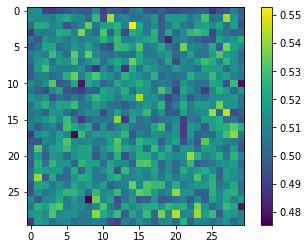

In [14]:
# 테스트
x = tf.random.normal([1,256,256,3])
y = tf.random.uniform([1,256,256,3])

disc_out = Discriminator()(x, y)
plt.imshow(disc_out[0, ... ,0])
plt.colorbar()

In [15]:
from tensorflow.keras import losses

bce = losses.BinaryCrossentropy(from_logits=False)
mae = losses.MeanAbsoluteError()

def get_gene_loss(fake_output, real_output, fake_disc):
    l1_loss = mae(real_output, fake_output)
    gene_loss = bce(tf.ones_like(fake_disc), fake_disc)
    return gene_loss, l1_loss

def get_disc_loss(fake_disc, real_disc):
    return bce(tf.zeros_like(fake_disc), fake_disc) + bce(tf.ones_like(real_disc), real_disc)


In [16]:
from tensorflow.keras import optimizers

gene_opt = optimizers.Adam(2e-4, beta_1=.5, beta_2=.999)
disc_opt = optimizers.Adam(2e-4, beta_1=.5, beta_2=.999)

In [31]:
@tf.function
def train_step(sketch, real_colored):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:

        fake_images = generator(sketch)
        
        real_disc = discriminator(real_colored,sketch)
        fake_disc = discriminator(fake_images,sketch)
        
        gene_loss,l1_loss = get_gene_loss(fake_images, real_colored, fake_disc)
        disc_loss = get_disc_loss(fake_disc, real_disc)
        gene_total_loss = l1_loss*100+gene_loss

    gene_gradient = gene_tape.gradient(gene_total_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return gene_loss, l1_loss, disc_loss

print("✅")

✅


In [18]:
EPOCHS = 10

generator = UNetGenerator()
discriminator = Discriminator()


for epoch in range(1, EPOCHS+1):
    for i, (sketch, colored) in enumerate(train_images):
        g_loss, l1_loss, d_loss = train_step(sketch, colored)
                
        # 10회 반복마다 손실을 출력합니다.
        if (i+1) % 10 == 0:
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \
                    \nGenerator_loss:{g_loss.numpy():.4f} \
                    \nL1_loss:{l1_loss.numpy():.4f} \
                    \nDiscriminator_loss:{d_loss.numpy():.4f}", end="\n\n")

EPOCH[1] - STEP[10]                     
Generator_loss:1.6928                     
L1_loss:0.4957                     
Discriminator_loss:0.5142

EPOCH[1] - STEP[20]                     
Generator_loss:0.2609                     
L1_loss:0.4196                     
Discriminator_loss:2.0770

EPOCH[1] - STEP[30]                     
Generator_loss:0.7854                     
L1_loss:0.2517                     
Discriminator_loss:1.2919

EPOCH[1] - STEP[40]                     
Generator_loss:0.7085                     
L1_loss:0.2392                     
Discriminator_loss:1.2532

EPOCH[1] - STEP[50]                     
Generator_loss:1.2373                     
L1_loss:0.2556                     
Discriminator_loss:1.4172

EPOCH[1] - STEP[60]                     
Generator_loss:0.7623                     
L1_loss:0.2236                     
Discriminator_loss:1.0783

EPOCH[1] - STEP[70]                     
Generator_loss:0.6357                     
L1_loss:0.3677                    

EPOCH[3] - STEP[70]                     
Generator_loss:1.0851                     
L1_loss:0.1659                     
Discriminator_loss:0.7925

EPOCH[3] - STEP[80]                     
Generator_loss:1.1976                     
L1_loss:0.1740                     
Discriminator_loss:0.9092

EPOCH[3] - STEP[90]                     
Generator_loss:1.3437                     
L1_loss:0.1651                     
Discriminator_loss:0.7547

EPOCH[3] - STEP[100]                     
Generator_loss:1.4201                     
L1_loss:0.1616                     
Discriminator_loss:0.6802

EPOCH[3] - STEP[110]                     
Generator_loss:1.1790                     
L1_loss:0.1779                     
Discriminator_loss:0.8016

EPOCH[3] - STEP[120]                     
Generator_loss:1.6299                     
L1_loss:0.1779                     
Discriminator_loss:0.7150

EPOCH[3] - STEP[130]                     
Generator_loss:1.3540                     
L1_loss:0.1850                

EPOCH[5] - STEP[130]                     
Generator_loss:1.1913                     
L1_loss:0.1885                     
Discriminator_loss:1.0215

EPOCH[5] - STEP[140]                     
Generator_loss:2.1296                     
L1_loss:0.1337                     
Discriminator_loss:1.0620

EPOCH[5] - STEP[150]                     
Generator_loss:1.3780                     
L1_loss:0.1641                     
Discriminator_loss:0.6264

EPOCH[5] - STEP[160]                     
Generator_loss:0.9851                     
L1_loss:0.1767                     
Discriminator_loss:1.0375

EPOCH[5] - STEP[170]                     
Generator_loss:1.4493                     
L1_loss:0.2133                     
Discriminator_loss:0.9000

EPOCH[5] - STEP[180]                     
Generator_loss:1.2150                     
L1_loss:0.1582                     
Discriminator_loss:0.9384

EPOCH[5] - STEP[190]                     
Generator_loss:1.2587                     
L1_loss:0.1920             

EPOCH[7] - STEP[190]                     
Generator_loss:1.4870                     
L1_loss:0.1423                     
Discriminator_loss:0.8587

EPOCH[7] - STEP[200]                     
Generator_loss:1.6488                     
L1_loss:0.1480                     
Discriminator_loss:0.5765

EPOCH[7] - STEP[210]                     
Generator_loss:0.8373                     
L1_loss:0.1734                     
Discriminator_loss:1.2946

EPOCH[7] - STEP[220]                     
Generator_loss:1.7542                     
L1_loss:0.1329                     
Discriminator_loss:0.9894

EPOCH[7] - STEP[230]                     
Generator_loss:1.1297                     
L1_loss:0.1834                     
Discriminator_loss:0.8229

EPOCH[7] - STEP[240]                     
Generator_loss:2.2832                     
L1_loss:0.1963                     
Discriminator_loss:0.7115

EPOCH[7] - STEP[250]                     
Generator_loss:0.4546                     
L1_loss:0.1990             

EPOCH[9] - STEP[250]                     
Generator_loss:1.4264                     
L1_loss:0.1826                     
Discriminator_loss:0.7585

EPOCH[10] - STEP[10]                     
Generator_loss:1.2504                     
L1_loss:0.1816                     
Discriminator_loss:0.9797

EPOCH[10] - STEP[20]                     
Generator_loss:2.1115                     
L1_loss:0.1557                     
Discriminator_loss:1.2099

EPOCH[10] - STEP[30]                     
Generator_loss:1.5272                     
L1_loss:0.1594                     
Discriminator_loss:0.7206

EPOCH[10] - STEP[40]                     
Generator_loss:1.0442                     
L1_loss:0.1589                     
Discriminator_loss:0.8803

EPOCH[10] - STEP[50]                     
Generator_loss:1.5896                     
L1_loss:0.1548                     
Discriminator_loss:0.5495

EPOCH[10] - STEP[60]                     
Generator_loss:1.6105                     
L1_loss:0.1734             

In [27]:
def show_result(data_path):
    for test_ind in range(0,4):
        f = data_path + os.listdir(data_path)[np.random.randint(len(os.listdir(data_path)))]
        sketch, colored = load_img(f)

        pred = generator(tf.expand_dims(sketch, 0))
        pred = denormalize(pred)

        plt.figure(figsize=(20,10))
        plt.subplot(1,3,1); plt.imshow(denormalize(sketch))
        plt.subplot(1,3,2); plt.imshow(pred[0])
        plt.subplot(1,3,3); plt.imshow(denormalize(colored))
        plt.show()


train


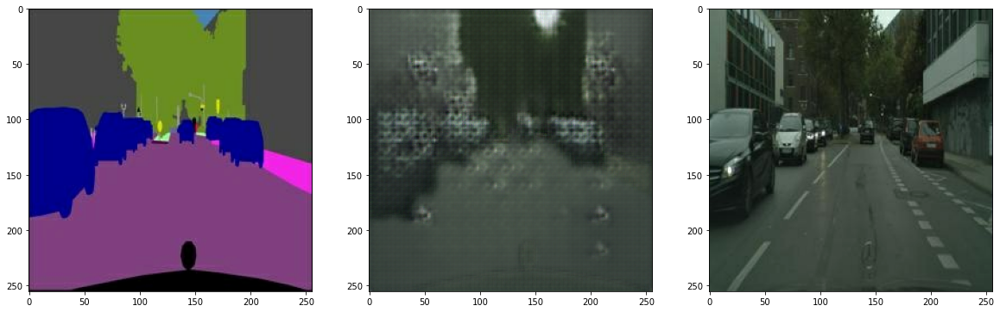

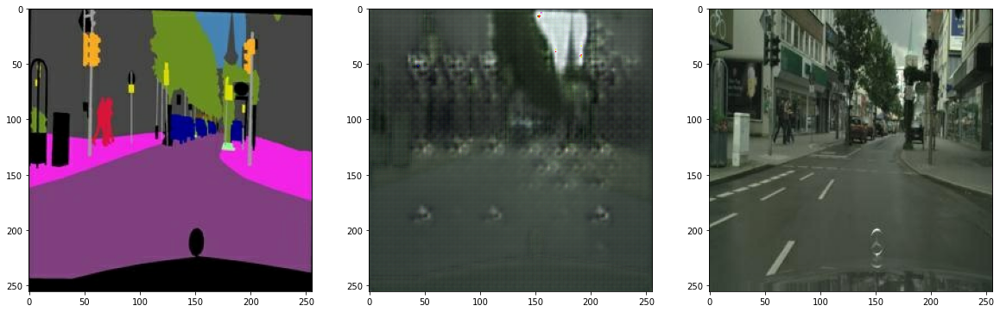

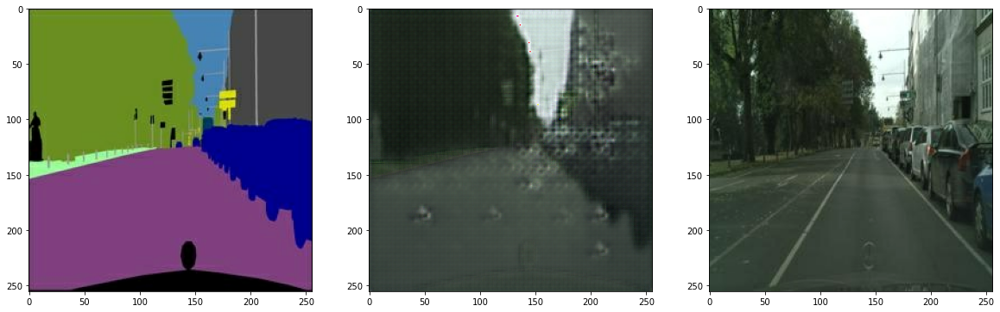

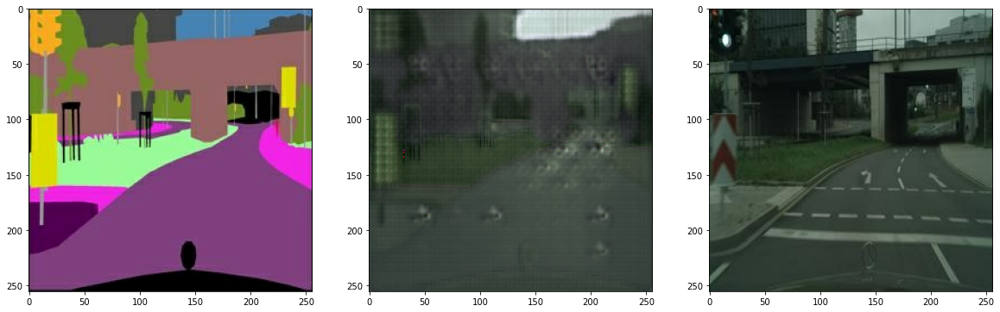

In [28]:
print("train")
show_result(train_data_path)

test


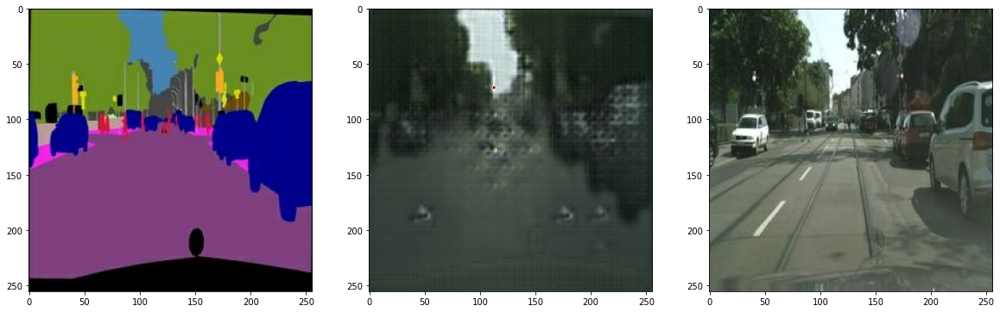

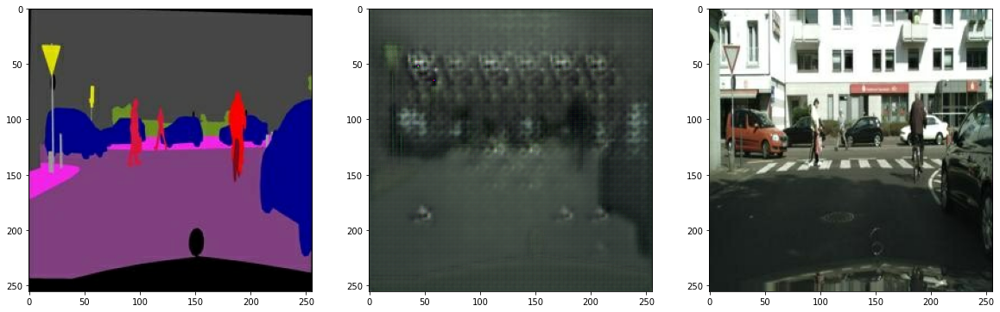

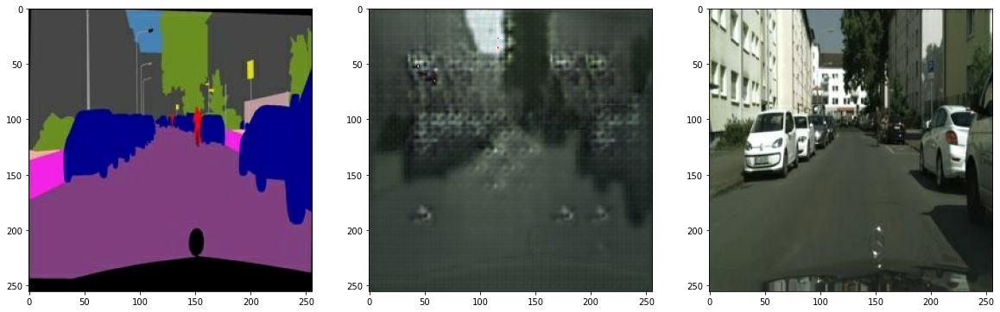

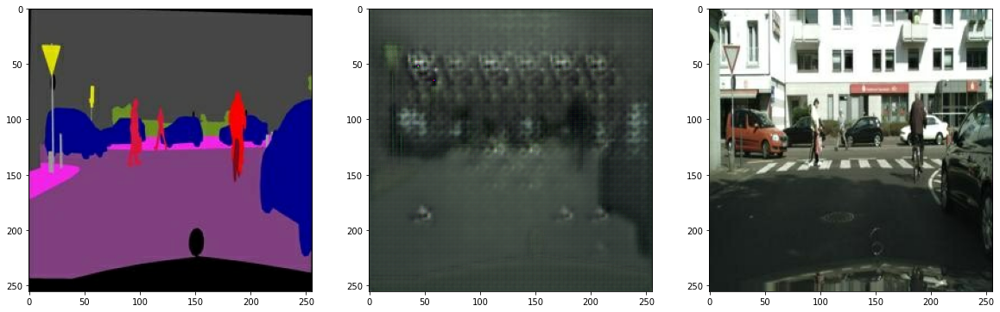

In [29]:
print("test")
show_result(test_data_path)

EPOCH[1] - STEP[250]                     
Generator_loss:1.0529                     
L1_loss:0.1815                     
Discriminator_loss:4.9584

EPOCH[2] - STEP[250]                     
Generator_loss:0.8749                     
L1_loss:0.1845                     
Discriminator_loss:1.8405

EPOCH[3] - STEP[250]                     
Generator_loss:1.0230                     
L1_loss:0.1905                     
Discriminator_loss:1.5991

EPOCH[4] - STEP[250]                     
Generator_loss:0.8274                     
L1_loss:0.2167                     
Discriminator_loss:1.5143

EPOCH[5] - STEP[250]                     
Generator_loss:0.8694                     
L1_loss:0.2150                     
Discriminator_loss:1.7280

Train result


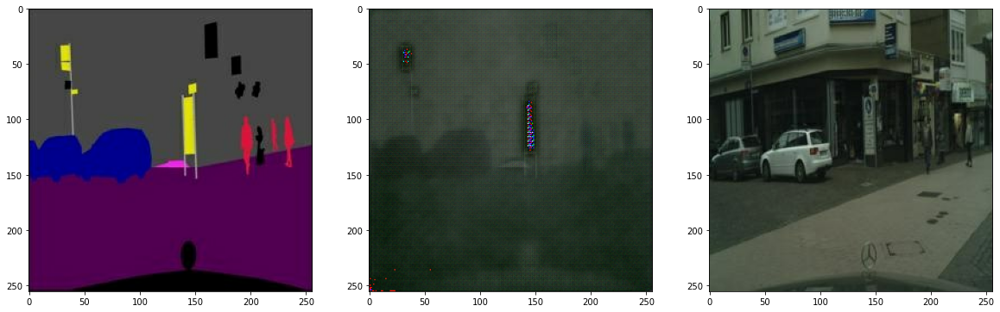

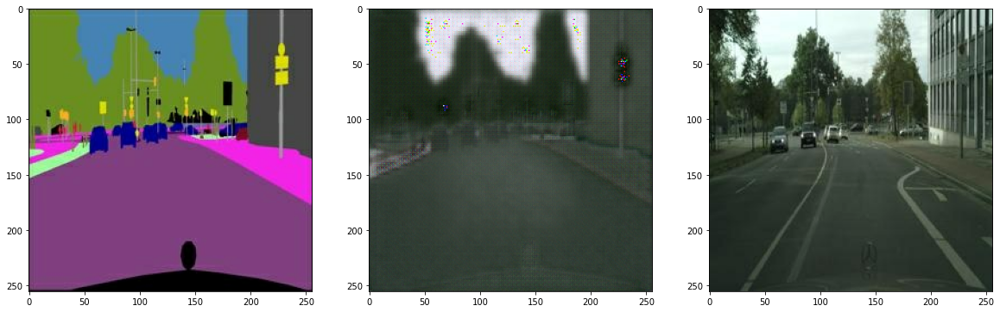

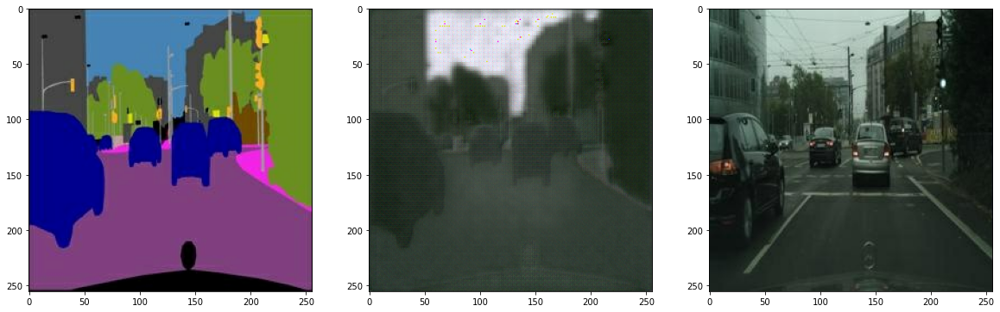

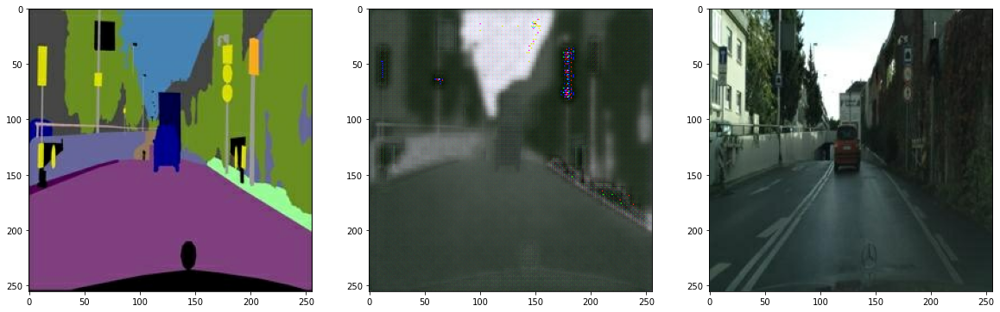

Test result


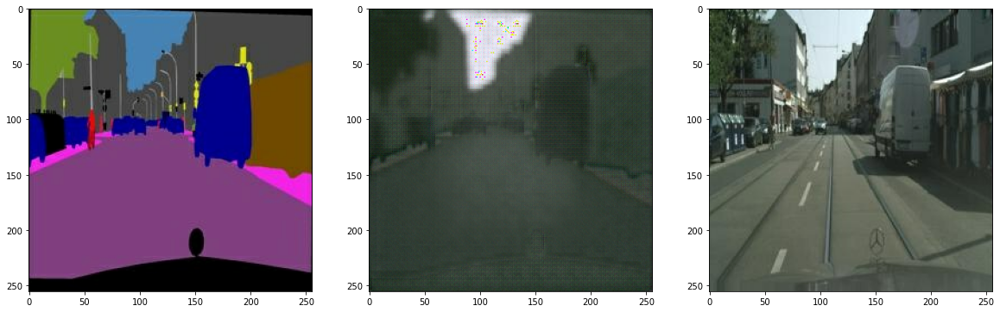

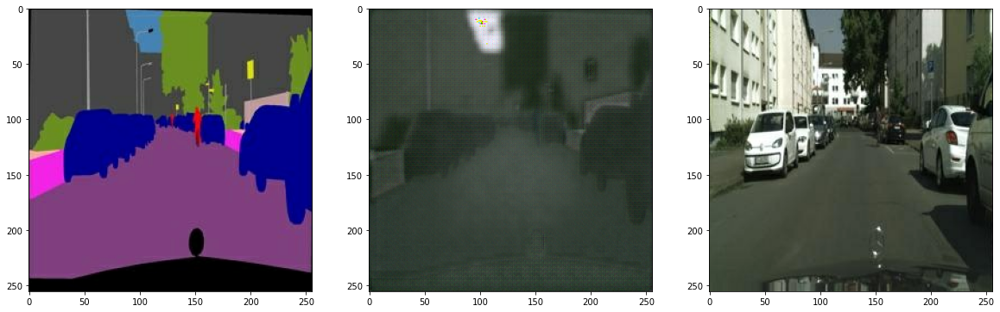

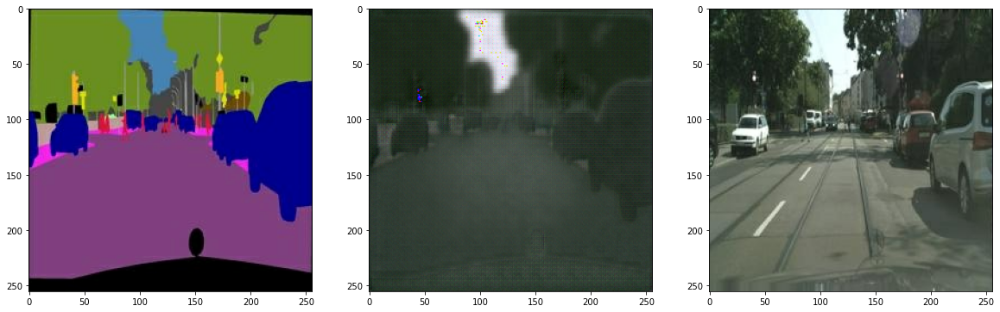

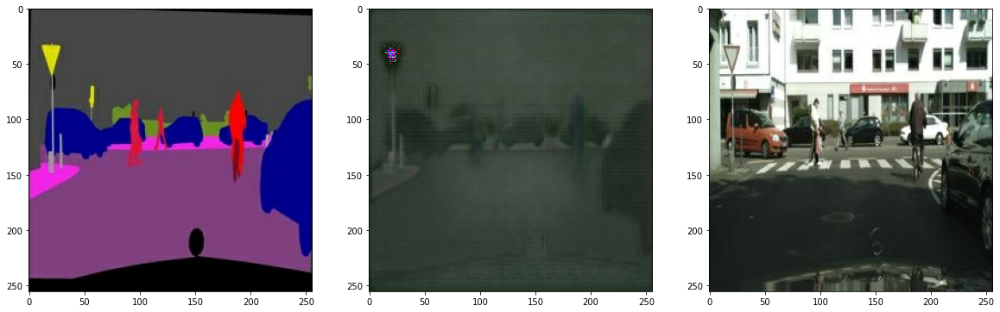

EPOCH[6] - STEP[250]                     
Generator_loss:1.0687                     
L1_loss:0.1826                     
Discriminator_loss:1.2442

EPOCH[7] - STEP[250]                     
Generator_loss:0.9877                     
L1_loss:0.2217                     
Discriminator_loss:1.4166

EPOCH[8] - STEP[250]                     
Generator_loss:1.1760                     
L1_loss:0.2061                     
Discriminator_loss:1.1623

EPOCH[9] - STEP[250]                     
Generator_loss:0.9259                     
L1_loss:0.2111                     
Discriminator_loss:1.1974

EPOCH[10] - STEP[250]                     
Generator_loss:0.8291                     
L1_loss:0.1851                     
Discriminator_loss:1.5525

Train result


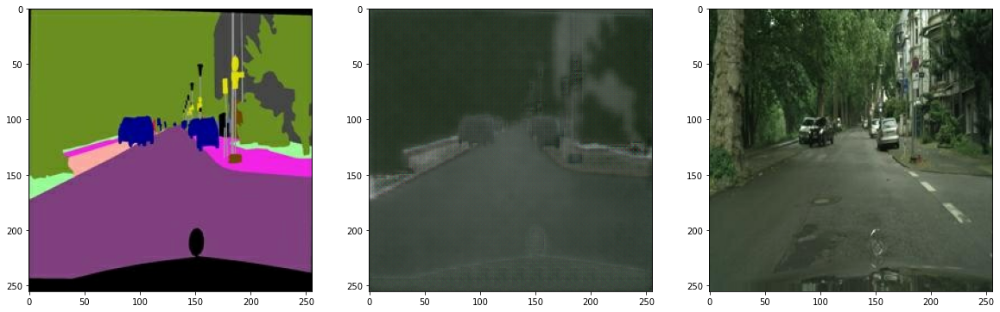

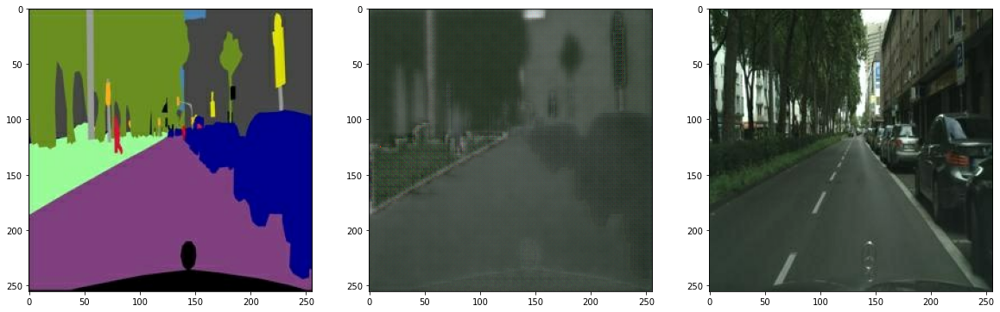

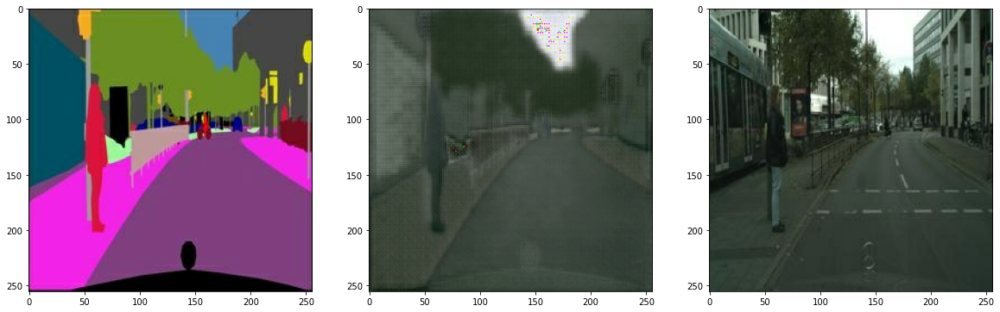

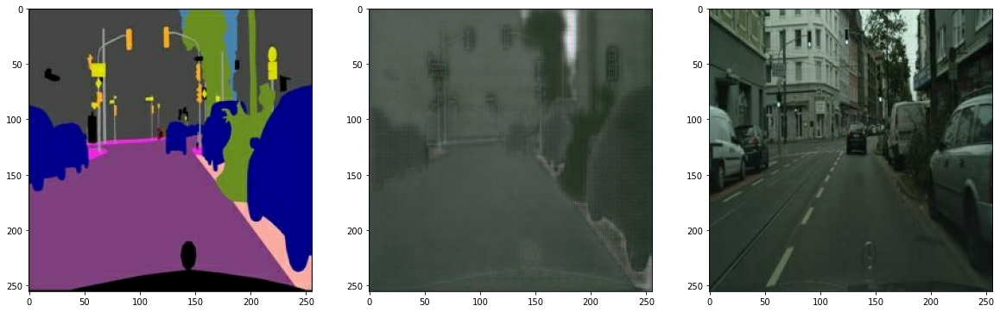

Test result


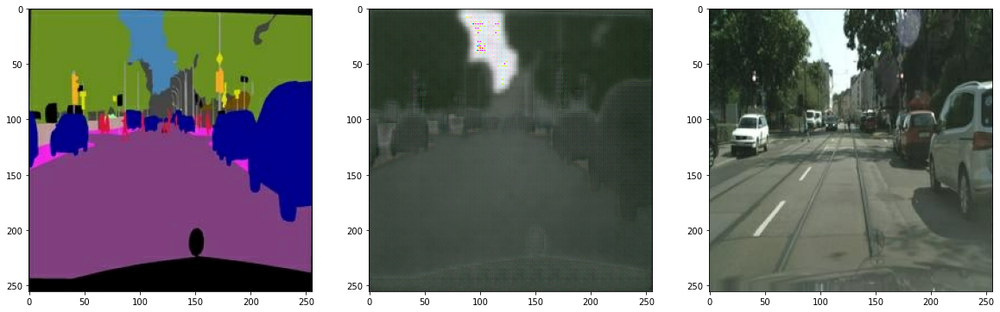

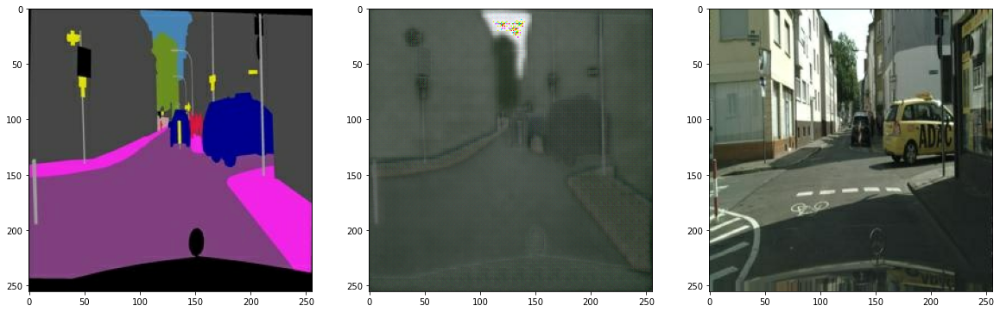

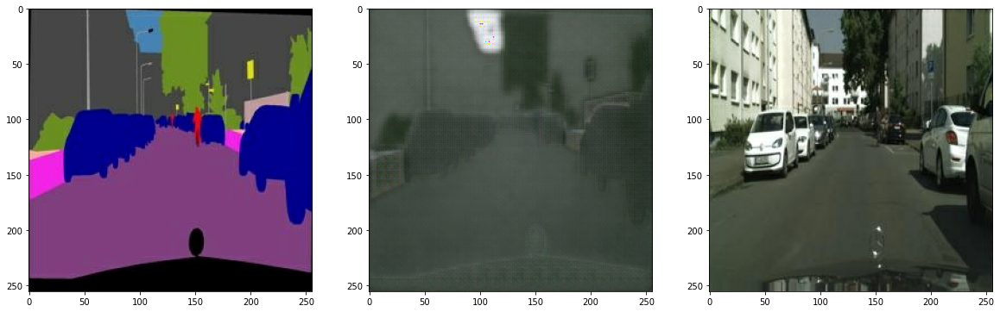

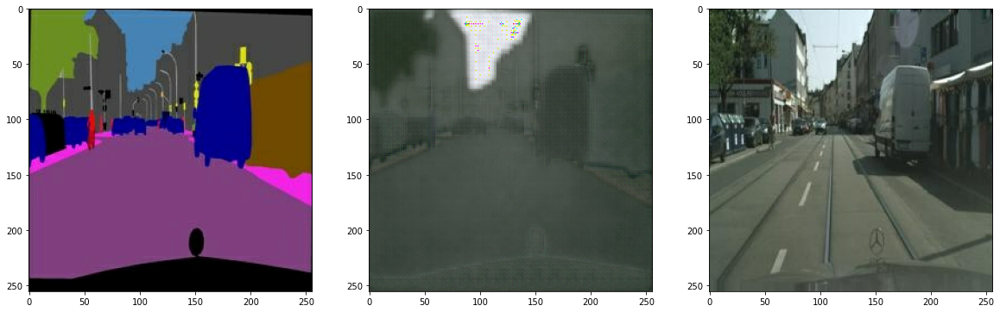

EPOCH[11] - STEP[250]                     
Generator_loss:0.8690                     
L1_loss:0.1349                     
Discriminator_loss:1.7266

EPOCH[12] - STEP[250]                     
Generator_loss:1.1534                     
L1_loss:0.1836                     
Discriminator_loss:0.9776

EPOCH[13] - STEP[250]                     
Generator_loss:0.9623                     
L1_loss:0.1823                     
Discriminator_loss:1.1527

EPOCH[14] - STEP[250]                     
Generator_loss:1.0970                     
L1_loss:0.1333                     
Discriminator_loss:1.2956

EPOCH[15] - STEP[250]                     
Generator_loss:0.9054                     
L1_loss:0.1950                     
Discriminator_loss:1.1499

Train result


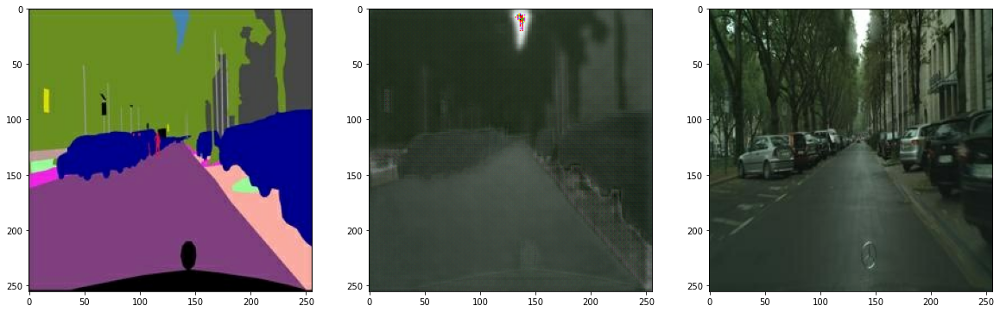

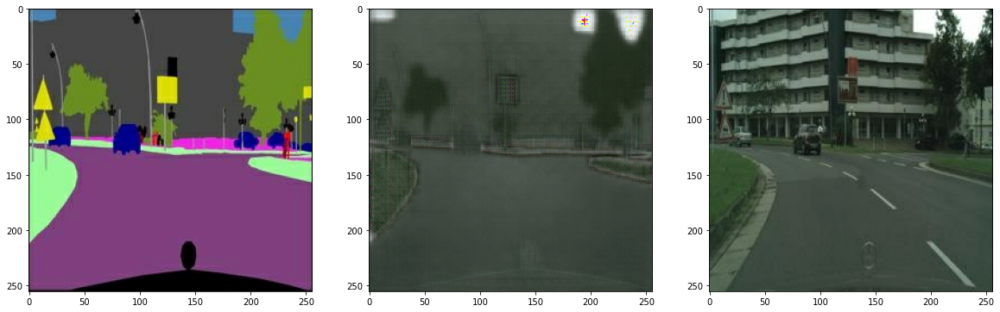

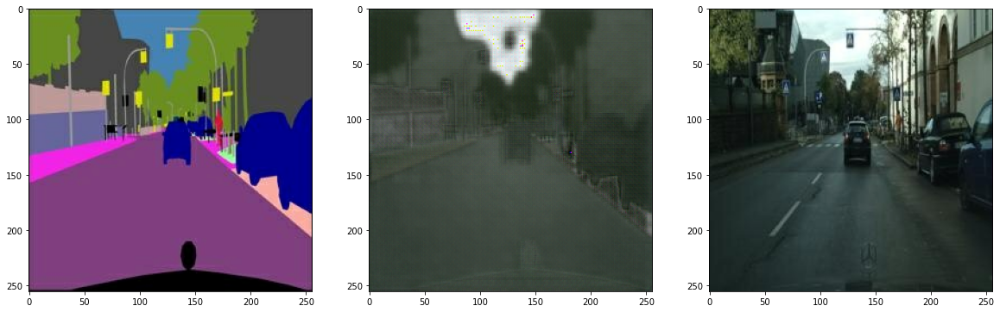

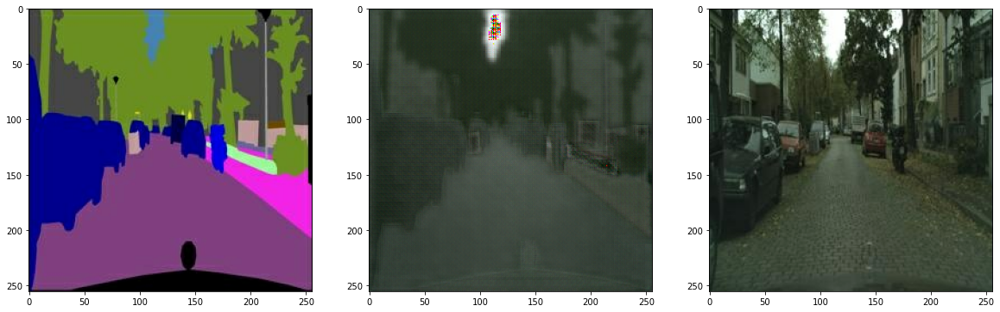

Test result


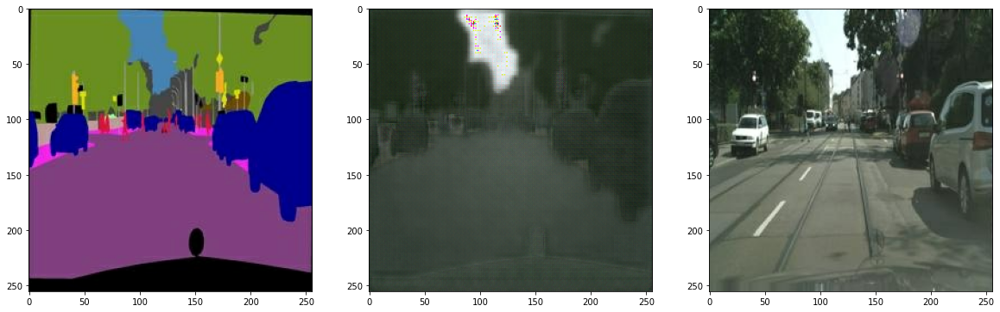

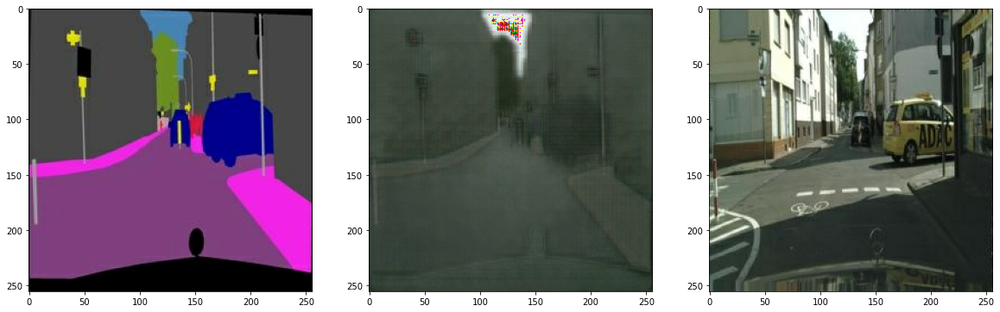

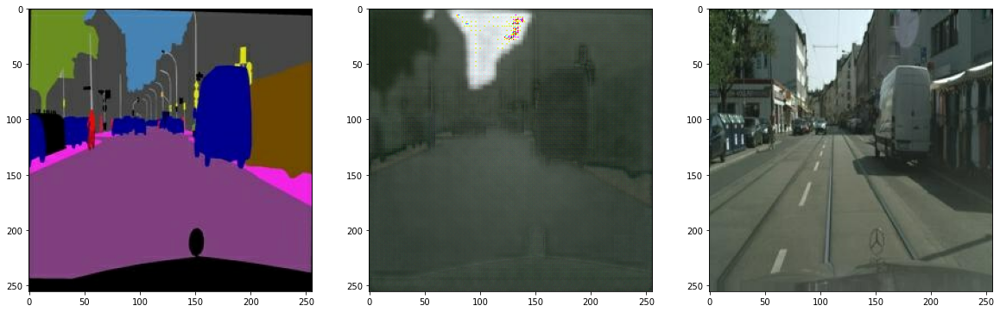

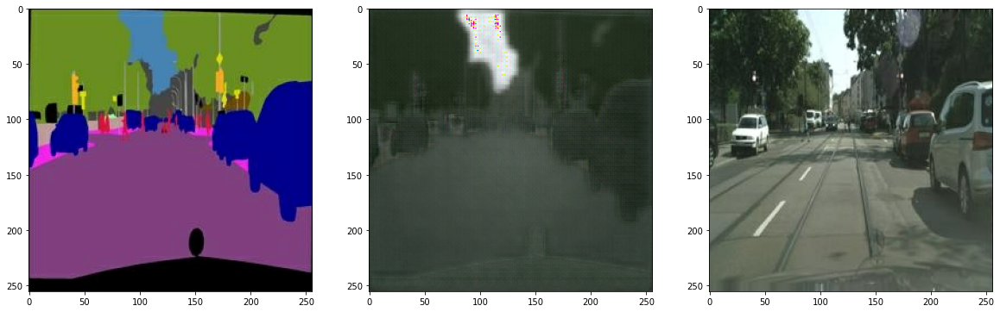

EPOCH[16] - STEP[250]                     
Generator_loss:0.8719                     
L1_loss:0.1883                     
Discriminator_loss:1.2978

EPOCH[17] - STEP[250]                     
Generator_loss:0.9954                     
L1_loss:0.1490                     
Discriminator_loss:1.2871

EPOCH[18] - STEP[250]                     
Generator_loss:1.1015                     
L1_loss:0.1419                     
Discriminator_loss:1.4273

EPOCH[19] - STEP[250]                     
Generator_loss:1.4528                     
L1_loss:0.1620                     
Discriminator_loss:1.0316

EPOCH[20] - STEP[250]                     
Generator_loss:1.2112                     
L1_loss:0.1692                     
Discriminator_loss:0.9953

Train result


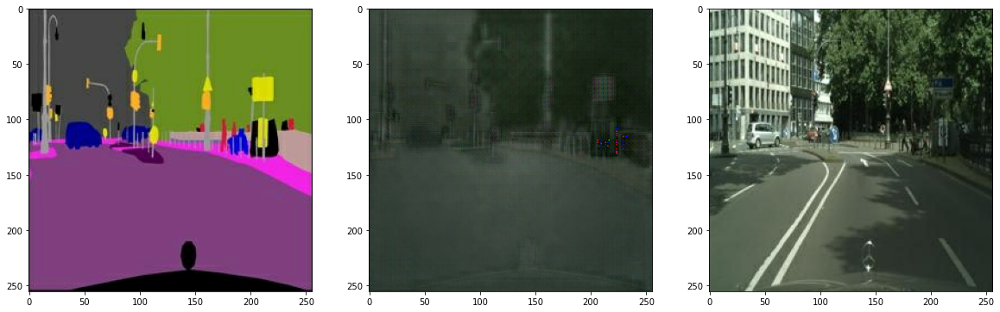

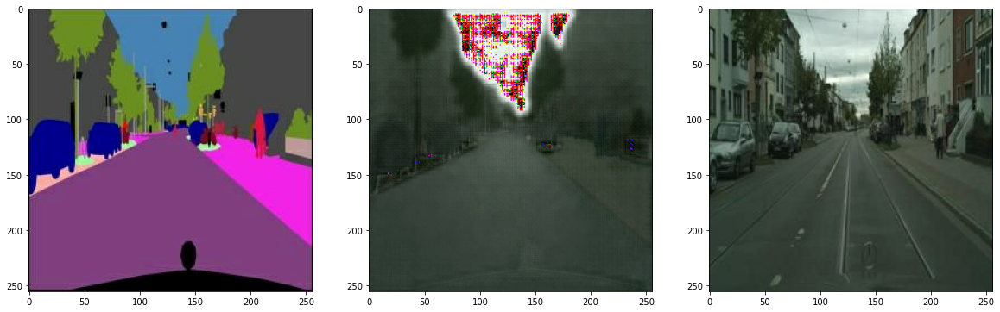

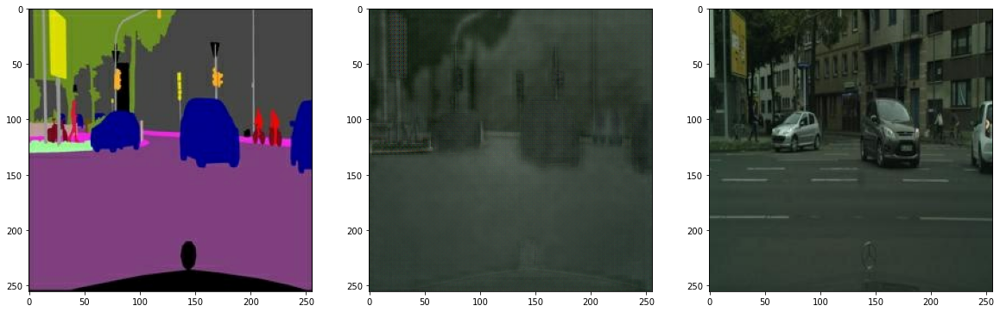

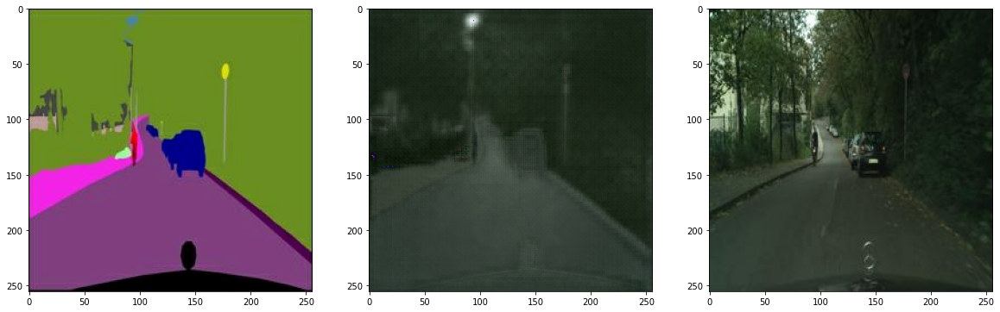

Test result


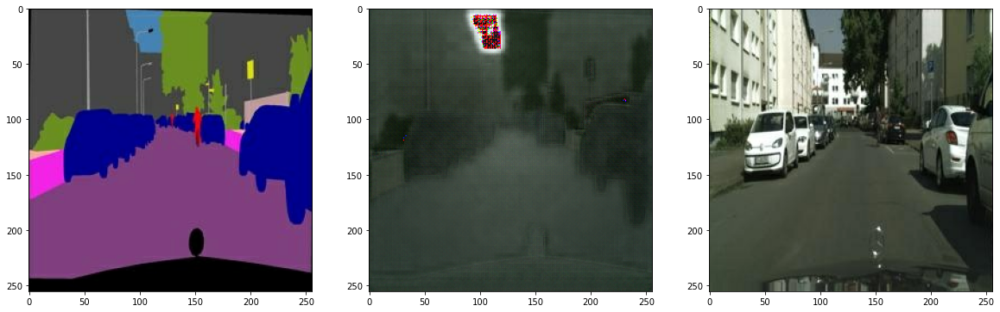

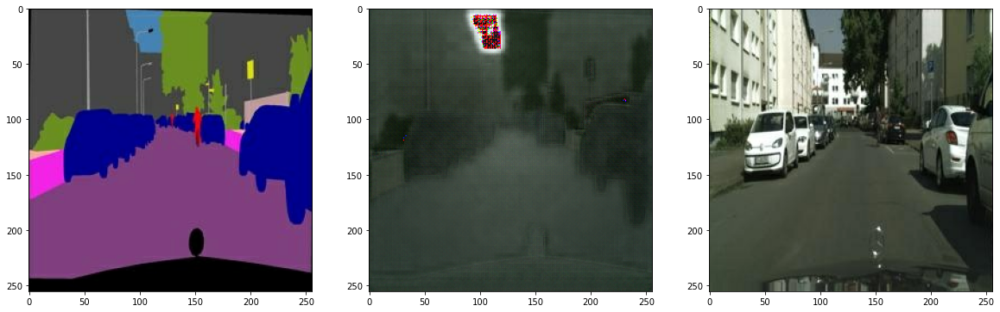

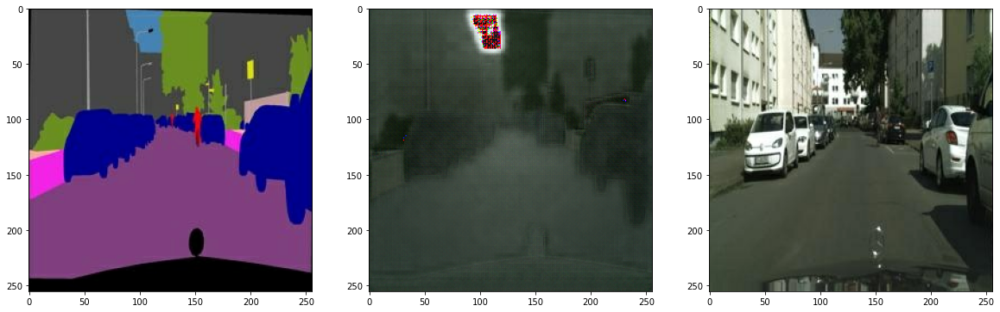

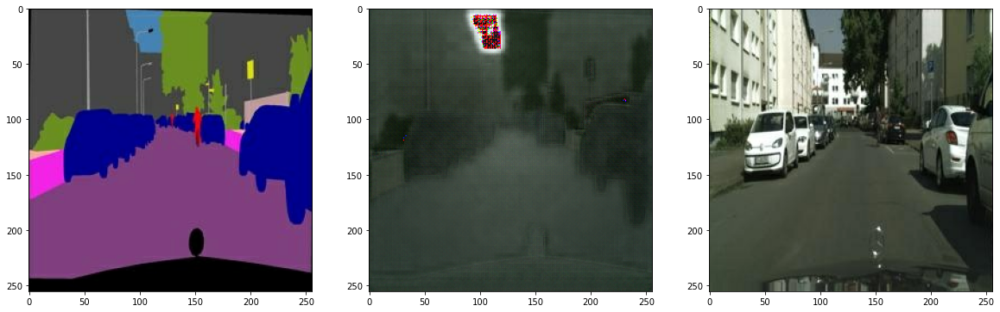

EPOCH[21] - STEP[250]                     
Generator_loss:1.1252                     
L1_loss:0.1962                     
Discriminator_loss:1.0562

EPOCH[22] - STEP[250]                     
Generator_loss:1.0554                     
L1_loss:0.1874                     
Discriminator_loss:1.0088

EPOCH[23] - STEP[250]                     
Generator_loss:1.2035                     
L1_loss:0.2044                     
Discriminator_loss:0.9010

EPOCH[24] - STEP[250]                     
Generator_loss:0.9636                     
L1_loss:0.1711                     
Discriminator_loss:0.9795

EPOCH[25] - STEP[250]                     
Generator_loss:1.0744                     
L1_loss:0.1559                     
Discriminator_loss:1.1040

Train result


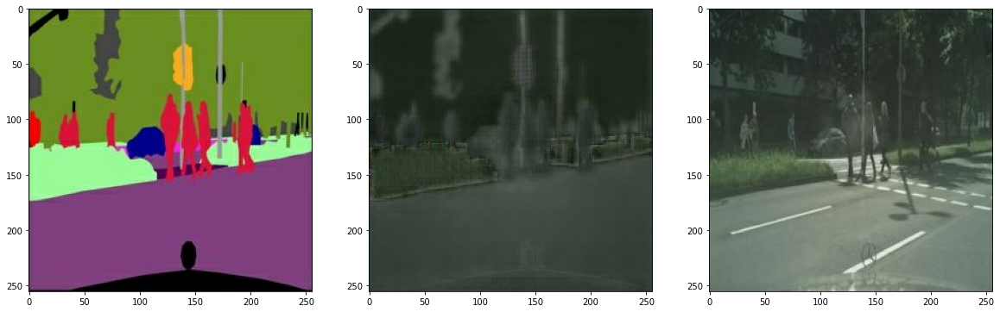

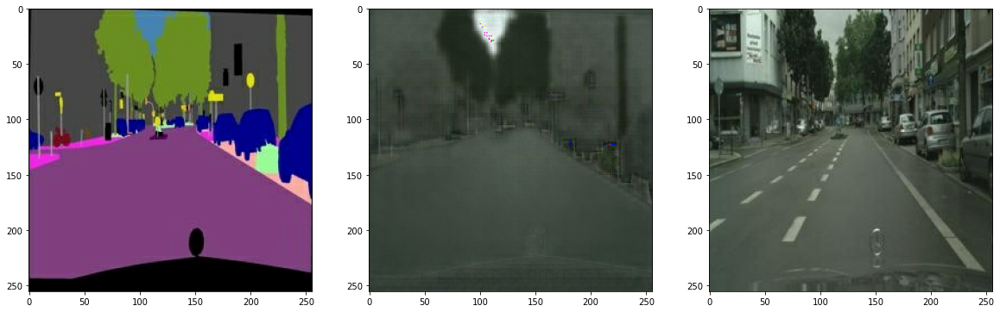

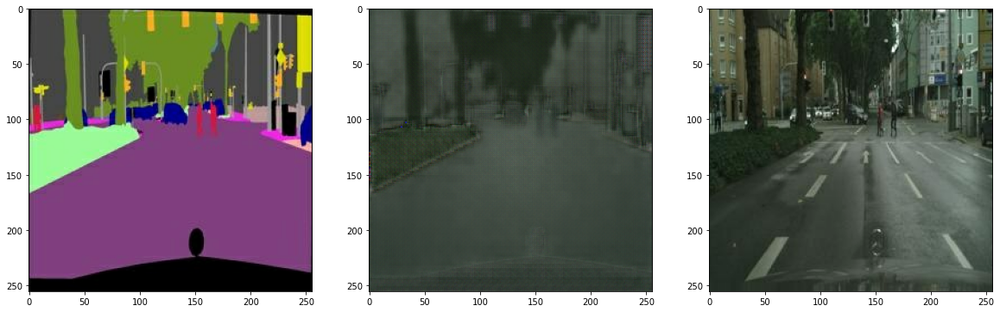

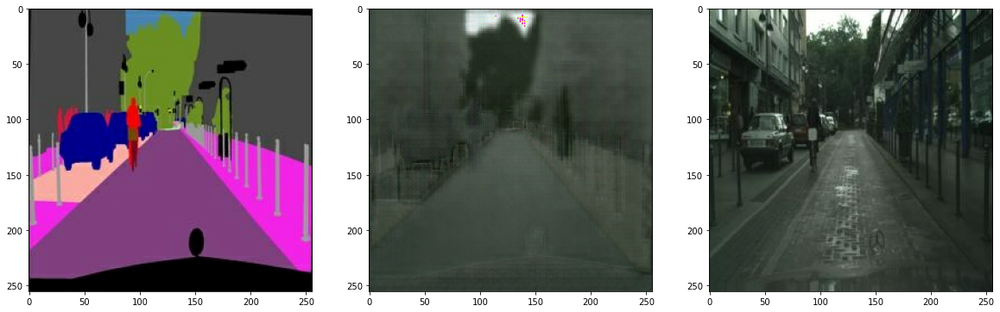

Test result


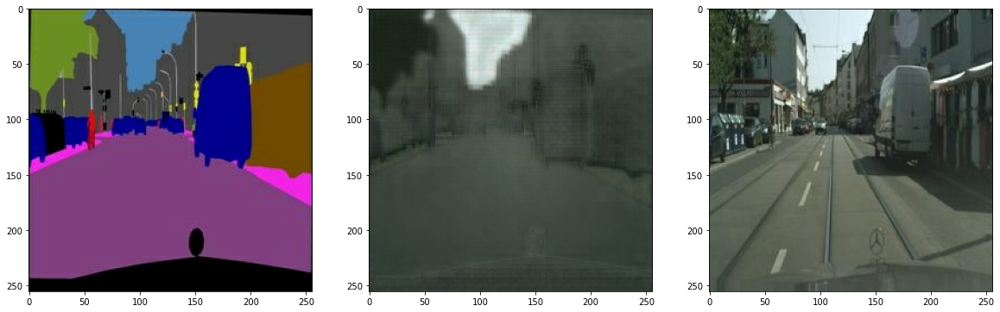

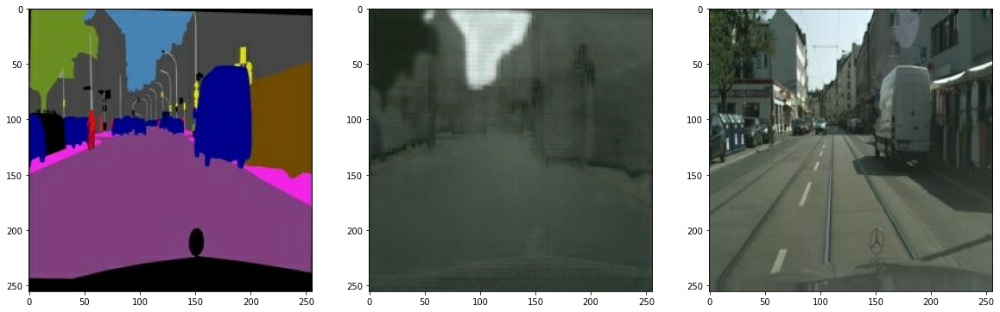

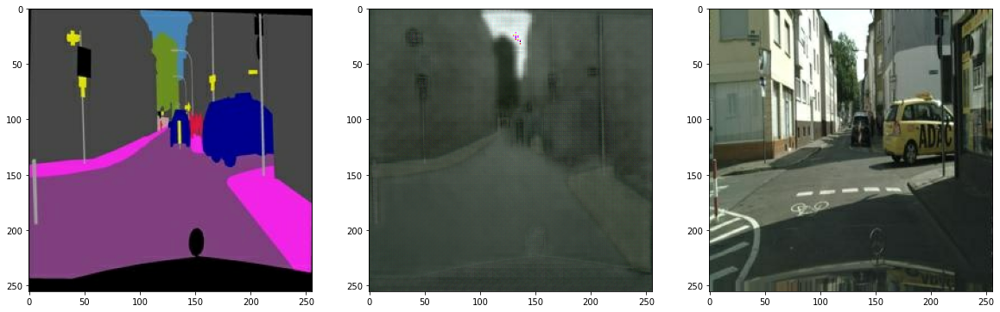

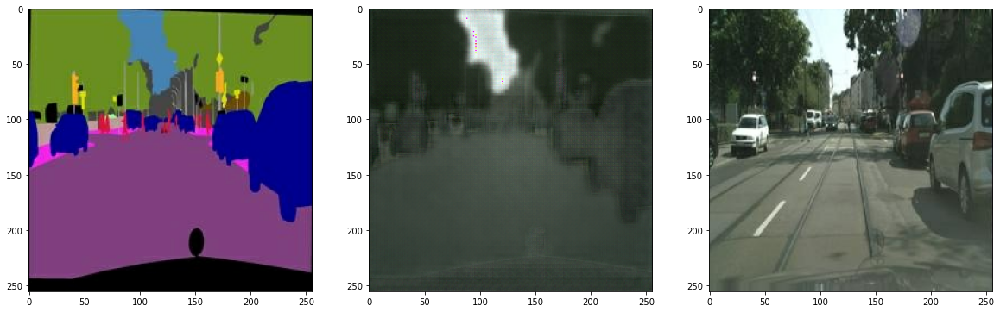

EPOCH[26] - STEP[250]                     
Generator_loss:1.0996                     
L1_loss:0.1307                     
Discriminator_loss:1.2124

EPOCH[27] - STEP[250]                     
Generator_loss:1.5952                     
L1_loss:0.1605                     
Discriminator_loss:1.0559

EPOCH[28] - STEP[250]                     
Generator_loss:1.0306                     
L1_loss:0.1399                     
Discriminator_loss:1.0806

EPOCH[29] - STEP[250]                     
Generator_loss:1.2258                     
L1_loss:0.1282                     
Discriminator_loss:1.1533

EPOCH[30] - STEP[250]                     
Generator_loss:1.3580                     
L1_loss:0.1687                     
Discriminator_loss:0.8434

Train result


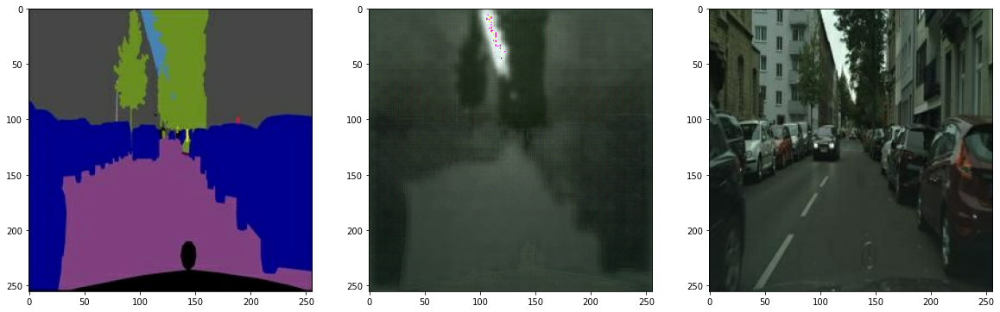

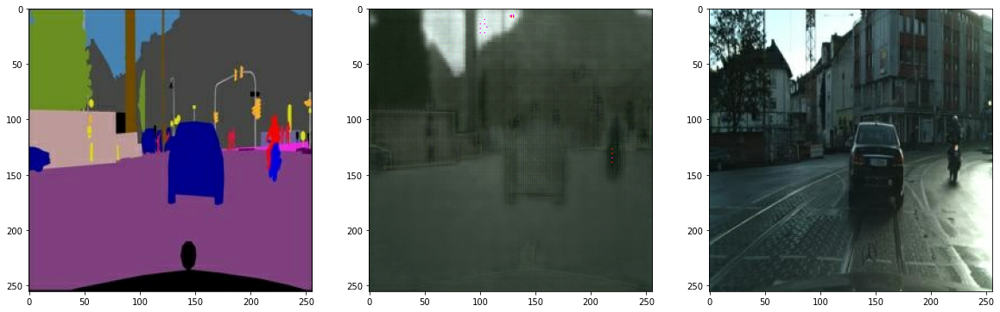

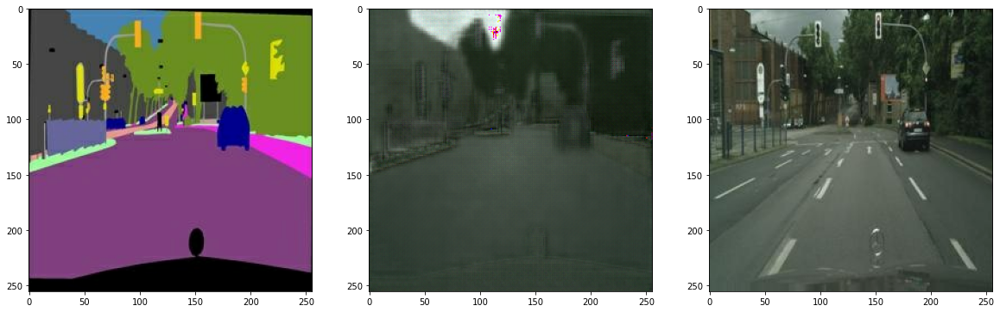

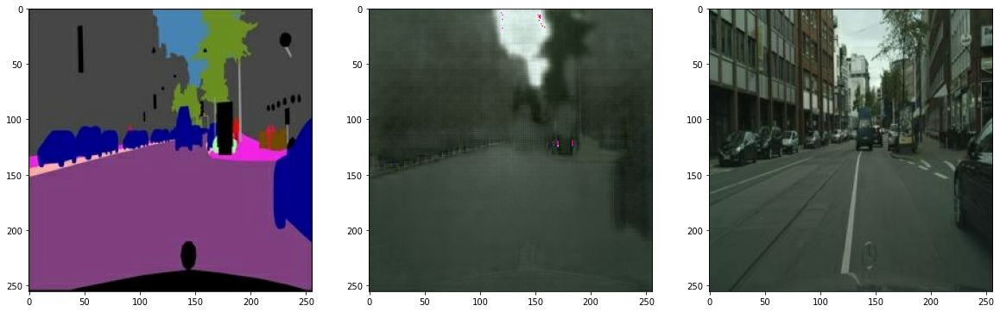

Test result


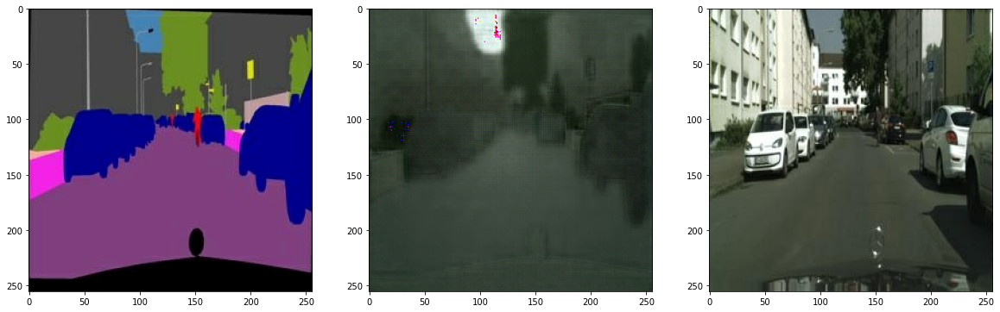

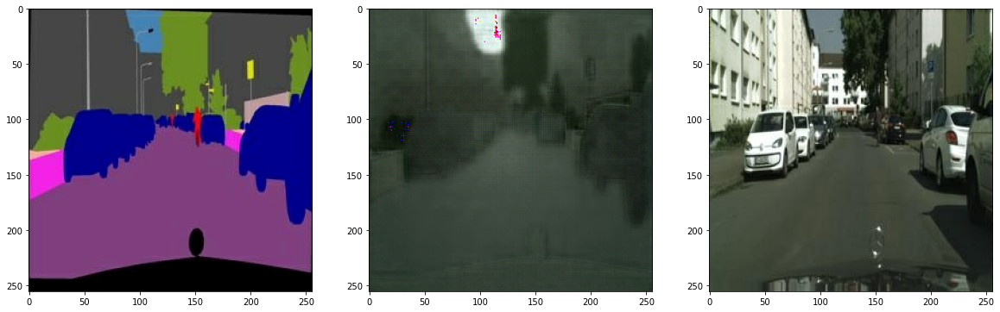

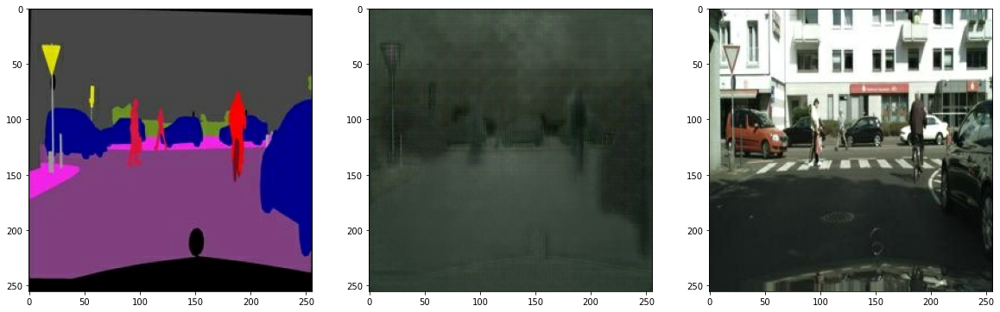

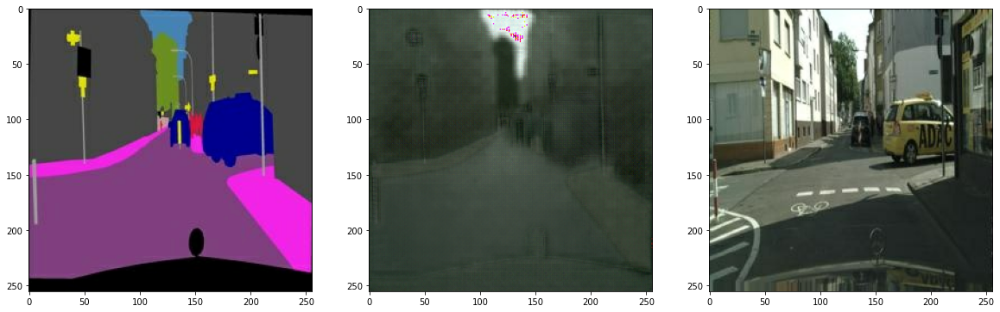

EPOCH[31] - STEP[250]                     
Generator_loss:0.8755                     
L1_loss:0.1848                     
Discriminator_loss:1.0543

EPOCH[32] - STEP[250]                     
Generator_loss:1.1137                     
L1_loss:0.1389                     
Discriminator_loss:1.1173

EPOCH[33] - STEP[250]                     
Generator_loss:1.0510                     
L1_loss:0.1437                     
Discriminator_loss:1.2068

EPOCH[34] - STEP[250]                     
Generator_loss:0.9931                     
L1_loss:0.1624                     
Discriminator_loss:1.1762

EPOCH[35] - STEP[250]                     
Generator_loss:1.0633                     
L1_loss:0.1433                     
Discriminator_loss:1.0127

Train result


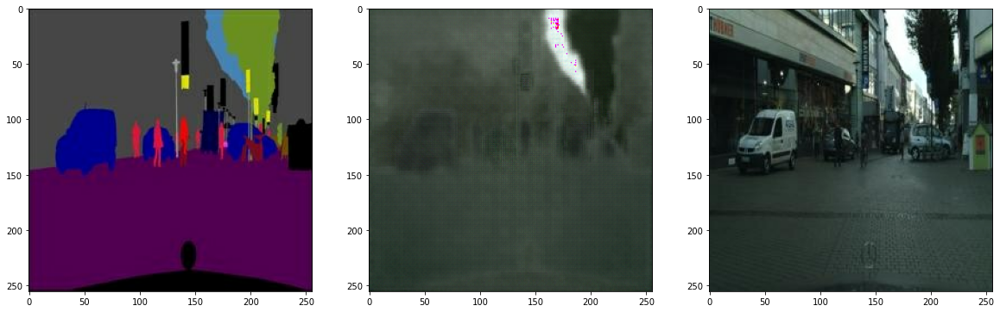

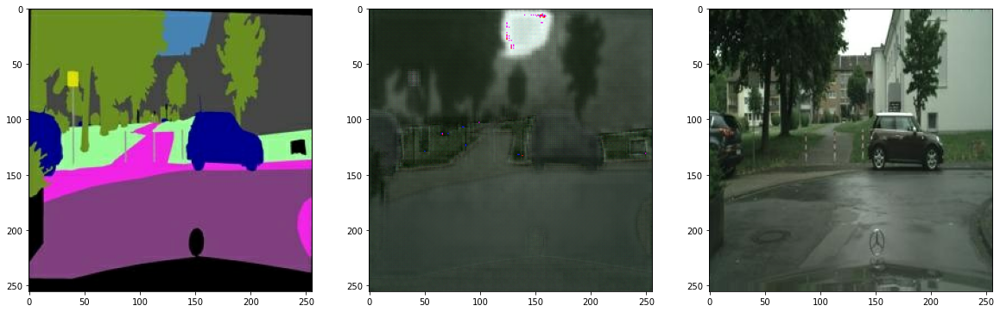

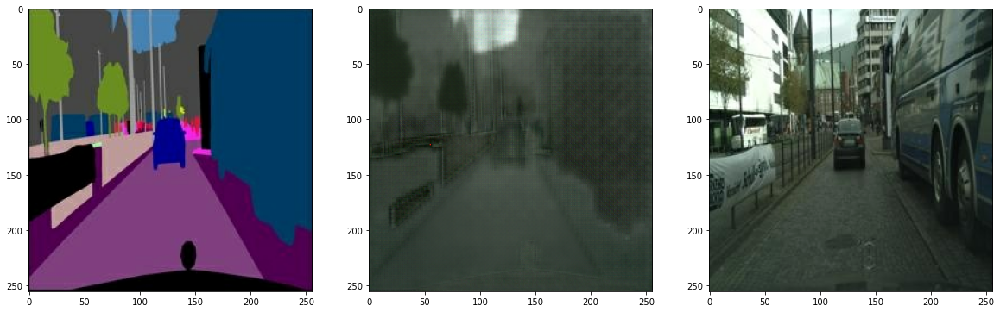

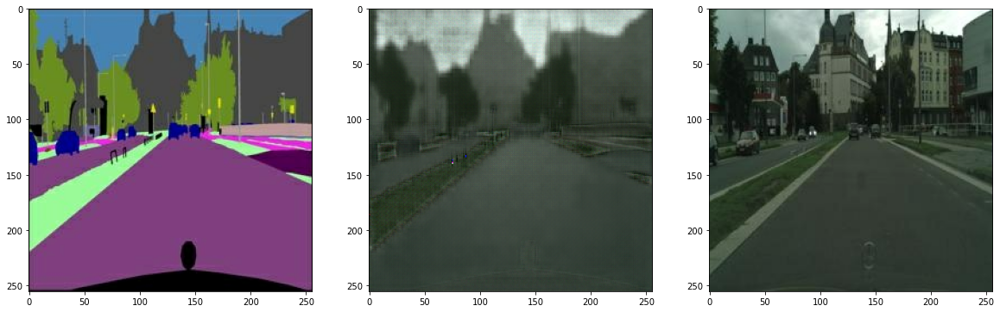

Test result


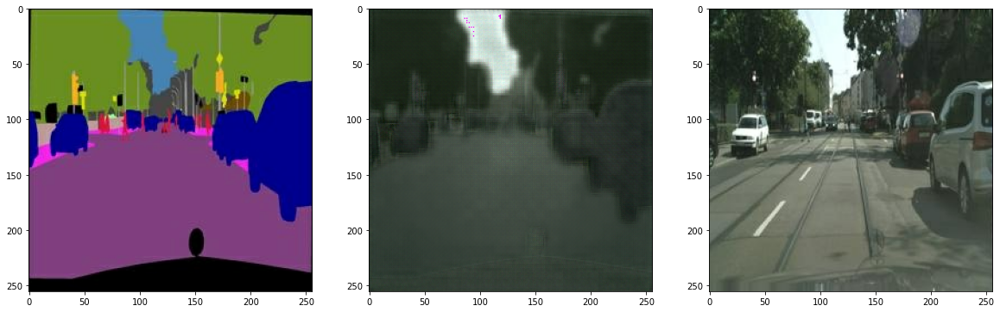

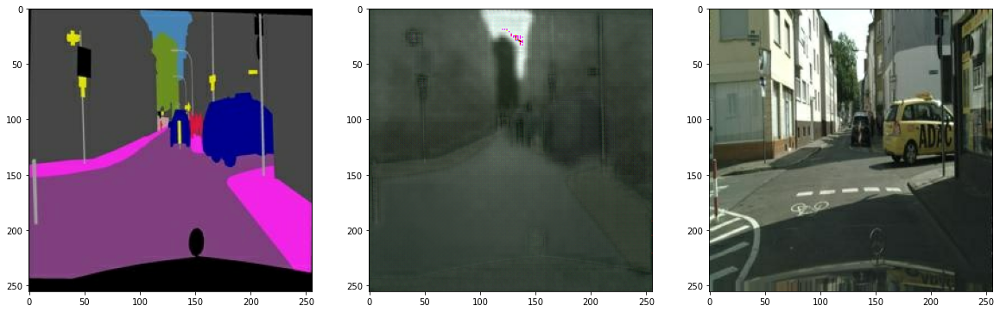

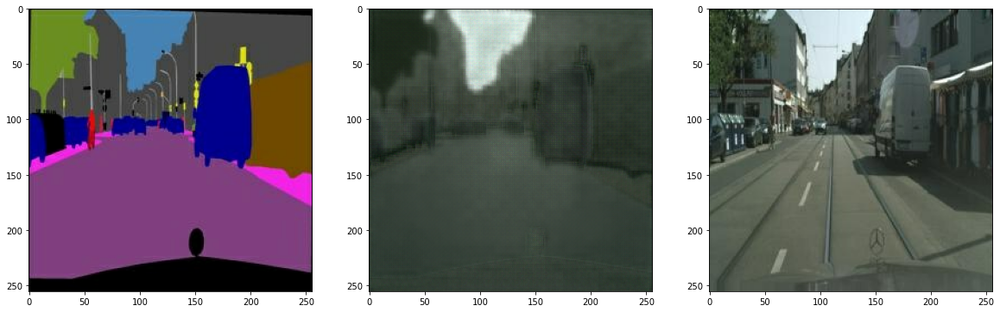

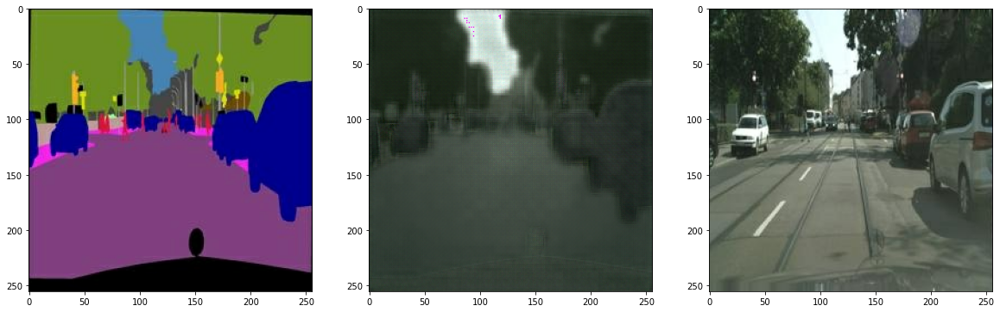

EPOCH[36] - STEP[250]                     
Generator_loss:1.0986                     
L1_loss:0.1519                     
Discriminator_loss:1.2244

EPOCH[37] - STEP[250]                     
Generator_loss:0.8241                     
L1_loss:0.1684                     
Discriminator_loss:1.3398

EPOCH[38] - STEP[250]                     
Generator_loss:1.4060                     
L1_loss:0.1444                     
Discriminator_loss:0.9507

EPOCH[39] - STEP[250]                     
Generator_loss:1.2076                     
L1_loss:0.1706                     
Discriminator_loss:0.9257

EPOCH[40] - STEP[250]                     
Generator_loss:0.8365                     
L1_loss:0.1428                     
Discriminator_loss:1.1301

Train result


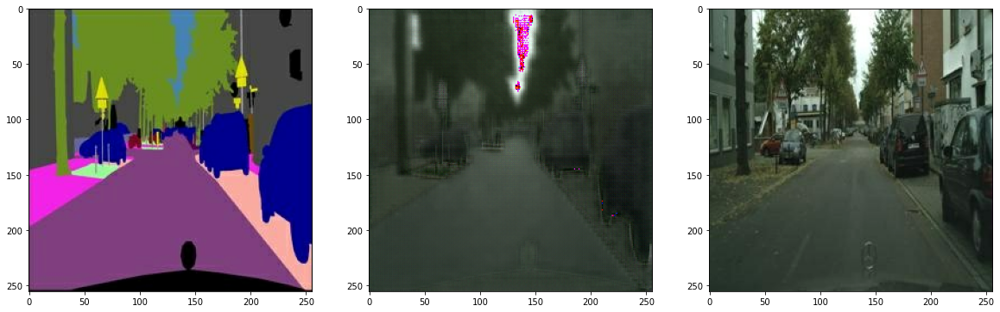

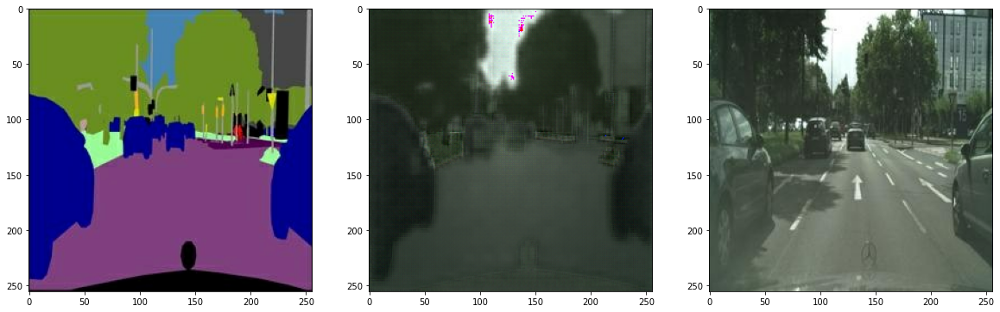

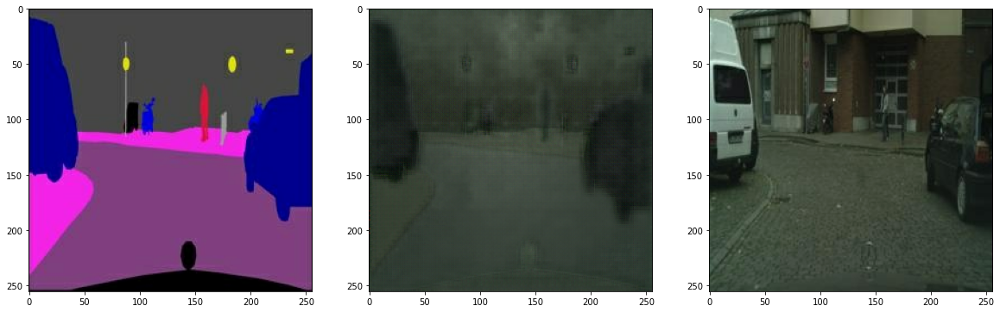

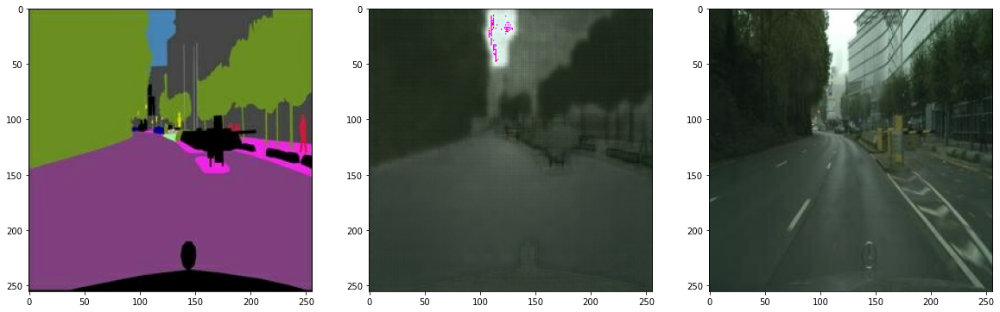

Test result


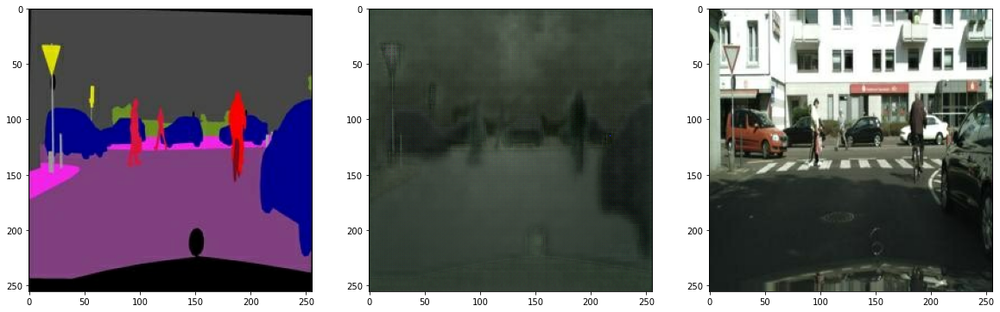

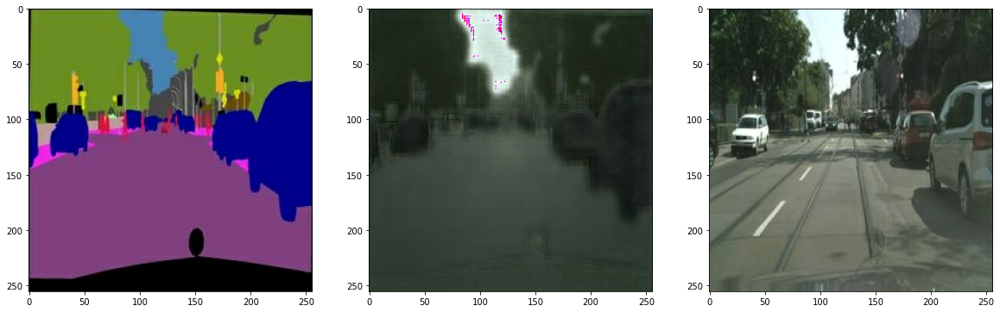

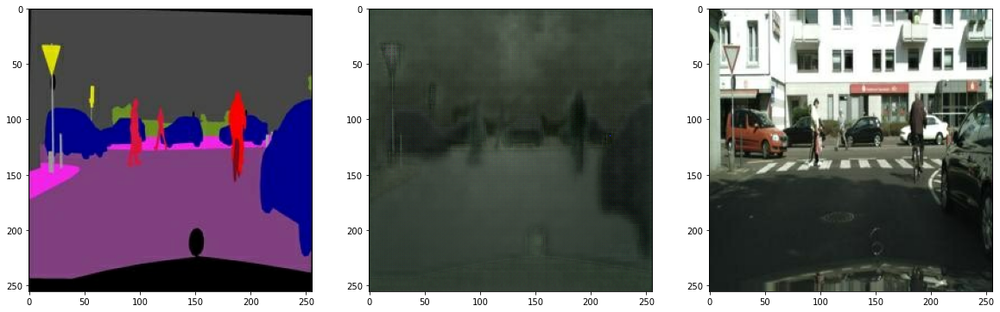

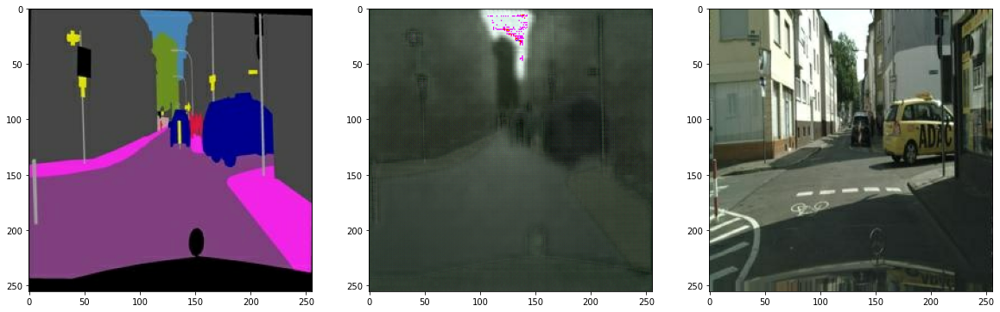

In [32]:
EPOCHS = 40

generator = UNetGenerator()
discriminator = Discriminator()
g_loss_arr, l1_loss_arr, d_loss_arr = [],[],[]

for epoch in range(1, EPOCHS+1):
    for i, (sketch, colored) in enumerate(train_images):
        g_loss, l1_loss, d_loss = train_step(sketch, colored)
        
        g_loss_arr.append(g_loss)
        l1_loss_arr.append(l1_loss)
        d_loss_arr.append(d_loss)
        
        
        # 10회 반복마다 손실을 출력합니다.
        if (i+1==250):
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \
                    \nGenerator_loss:{g_loss.numpy():.4f} \
                    \nL1_loss:{l1_loss.numpy():.4f} \
                    \nDiscriminator_loss:{d_loss.numpy():.4f}", end="\n\n")
            if epoch % 5 == 0:
                print("Train result")
                show_result(train_data_path)
                print("Test result")
                show_result(test_data_path)                

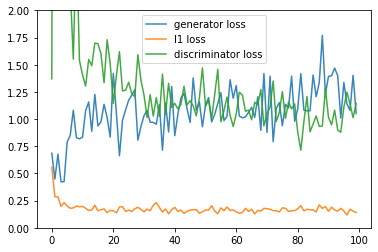

In [45]:
x = list(range(0,100))
plt.plot(x,[val for i, val in enumerate(g_loss_arr) if i % 100 == 0],label="generator loss",alpha = 0.89)
plt.plot(x,[val for i, val in enumerate(l1_loss_arr) if i % 100 == 0],label = "l1 loss",alpha = 0.89)
plt.plot(x,[val for i, val in enumerate(d_loss_arr) if i % 100 == 0], label = "discriminator loss",alpha = 0.89)
plt.ylim(0,2)
plt.legend()
plt.show()

### 회고

### 개요
- Segmentation map으로 도로 레이블 정보를 활용해 이미지 생성

### 과정
- 데이터 증강
- Generator
- U-Net Generator
- 모델 학습 후 학습된 Generator로 테스트
- 결과를 스케치, 생성된 사진, 실제 사진 순서로 나란히 시각화
- 10, 40 epoch 이상의 학습
- 손실값에 대한 로그 시각화

### 느낀점
- 